# Speech Understanding
## Assignment 1
#### Question 2B
### Akansha Gautam (M23CSA506)

# Importing Libraries

In [2]:
import numpy as np
import pandas as pd
import torch
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.io import wavfile as wav
import IPython.display as ipd
import librosa.display
import torchaudio
import torchaudio.transforms as transforms

# Set Device

In [3]:
if torch.backends.mps.is_available():
    device = 'mps'
elif torch.cuda.is_available():
    device = 'cuda'
else:
    device = 'cpu'

print(f"Using device: {device}")

Using device: mps


# Load 4 songs from 4 different genres in high and low resource languages

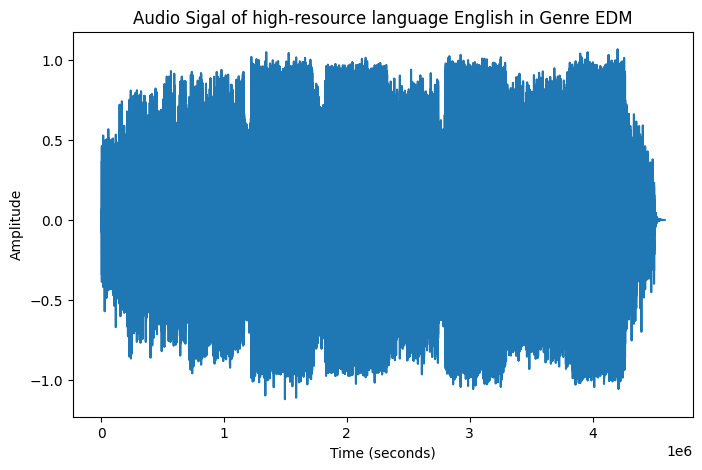

In [14]:
# High Resource Language: English
# Genre: EDM
file_path1 = '/Users/akanshagautam/Documents/MTech/Speech Understanding/Assignment 1/songs/edm_english.mp3'

x, _ = librosa.load(file_path1)
plt.figure(figsize=(8,5))
plt.title(f"Audio Sigal of high-resource language English in Genre EDM")
plt.xlabel("Time (seconds)")
plt.ylabel("Amplitude")
plt.plot(x)

ipd.Audio(file_path1)

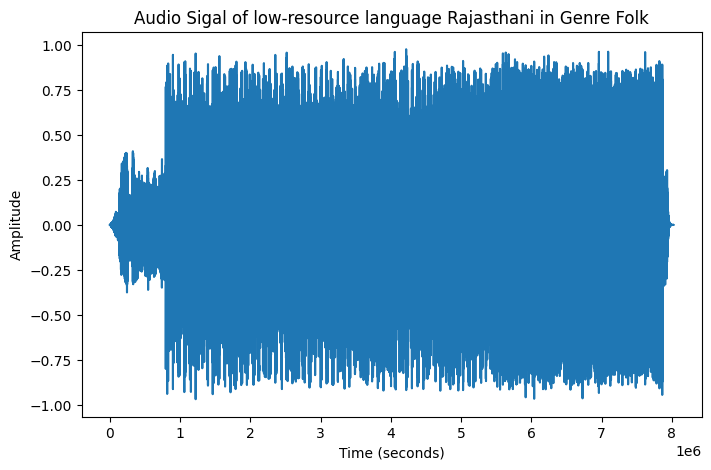

In [15]:
# Low Resource Language: Rajasthani
# Genre: Folk
file_path2 = '/Users/akanshagautam/Documents/MTech/Speech Understanding/Assignment 1/songs/folk_rajasthani.mp3'

x, _ = librosa.load(file_path2)
plt.figure(figsize=(8,5))
plt.title(f"Audio Sigal of low-resource language Rajasthani in Genre Folk")
plt.xlabel("Time (seconds)")
plt.ylabel("Amplitude")
plt.plot(x)

ipd.Audio(file_path2)

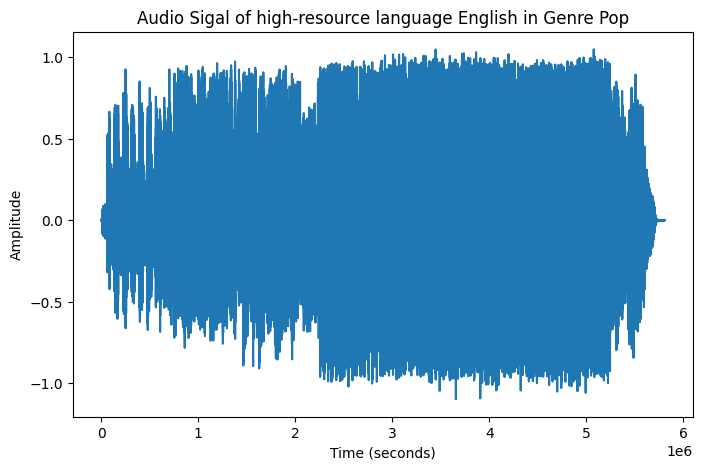

In [16]:
# High Resource Language: English
# Genre: Pop
file_path3 = '/Users/akanshagautam/Documents/MTech/Speech Understanding/Assignment 1/songs/pop_english.mp3'

x, _ = librosa.load(file_path3)
plt.figure(figsize=(8,5))
plt.title(f"Audio Sigal of high-resource language English in Genre Pop")
plt.xlabel("Time (seconds)")
plt.ylabel("Amplitude")
plt.plot(x)

ipd.Audio(file_path3)

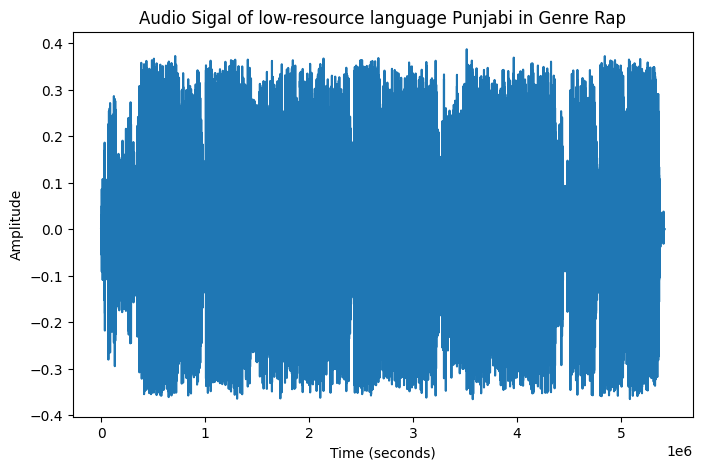

In [17]:
# Low Resource Language: Punjabi
# Genre: Rap
file_path4 = '/Users/akanshagautam/Documents/MTech/Speech Understanding/Assignment 1/songs/rap_punjabi.mp3'

x, _ = librosa.load(file_path4)
plt.figure(figsize=(8,5))
plt.title(f"Audio Sigal of low-resource language Punjabi in Genre Rap")
plt.xlabel("Time (seconds)")
plt.ylabel("Amplitude")
plt.plot(x)

ipd.Audio(file_path4)

# Spectograms

In [29]:
def get_hann_window(signal_length=1024):
    hann_window = []
    for i in range(0, signal_length):
        hann_window.append(0.5 * (1 - np.cos((2 * np.pi * i)/(signal_length-1))))
    return hann_window

def apply_hann_window(signal, hann_window):
    return signal * hann_window

def get_stft_hann_db(file_path, sample_rate, win_length, hop_length):
    signal, sample_rate = librosa.load(file_path, sr=sample_rate)

    hann_window = get_hann_window()
    stft_hann = librosa.stft(signal, n_fft=win_length, hop_length=hop_length, win_length=win_length, window=hann_window)
    stft_hann_db = librosa.amplitude_to_db(np.abs(stft_hann), ref=np.max)
    return stft_hann_db

## High Resource Language: English
##  Genre: EDM

Text(0, 0.5, 'Frequency (Hz)')

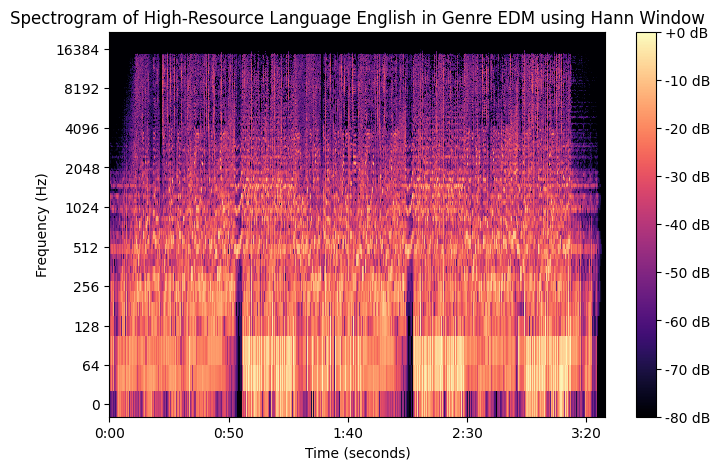

In [30]:
hop_length = 512
win_length = 1024
sample_rate = 44100

stft_hann_db = get_stft_hann_db(file_path1, sample_rate, win_length, hop_length)
plt.figure(figsize=(8, 5))
librosa.display.specshow(stft_hann_db, sr=sample_rate, hop_length=hop_length, x_axis='time', y_axis='log')
plt.colorbar(format='%+2.0f dB')
plt.title("Spectrogram of High-Resource Language English in Genre EDM using Hann Window")
plt.xlabel("Time (seconds)")
plt.ylabel("Frequency (Hz)")

## Low Resource Language: Rajasthani
## Genre: Folk

Text(0, 0.5, 'Frequency (Hz)')

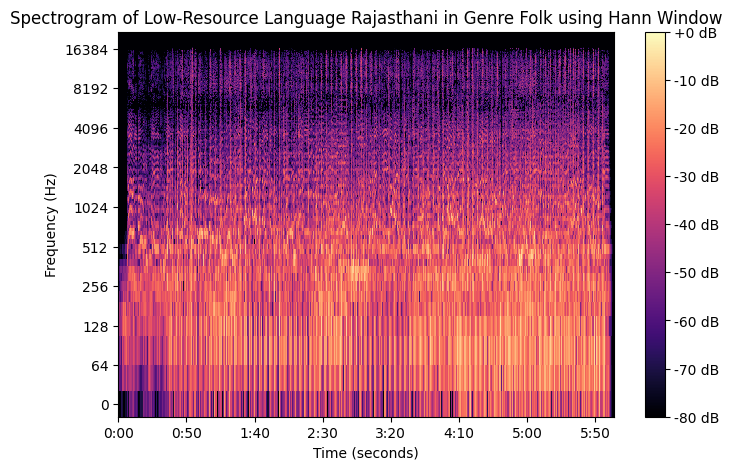

In [32]:
stft_hann_db = get_stft_hann_db(file_path2, sample_rate, win_length, hop_length)
plt.figure(figsize=(8, 5))
librosa.display.specshow(stft_hann_db, sr=sample_rate, hop_length=hop_length, x_axis='time', y_axis='log')
plt.colorbar(format='%+2.0f dB')
plt.title("Spectrogram of Low-Resource Language Rajasthani in Genre Folk using Hann Window")
plt.xlabel("Time (seconds)")
plt.ylabel("Frequency (Hz)")

## High Resource Language: English
## Genre: Pop

Text(0, 0.5, 'Frequency (Hz)')

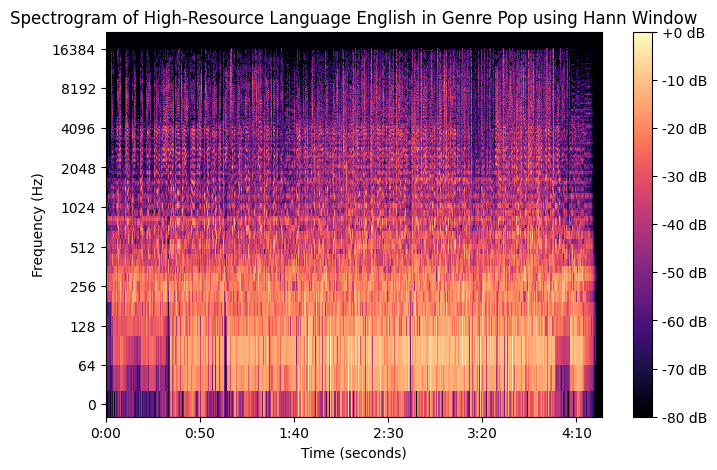

In [33]:
stft_hann_db = get_stft_hann_db(file_path3, sample_rate, win_length, hop_length)
plt.figure(figsize=(8, 5))
librosa.display.specshow(stft_hann_db, sr=sample_rate, hop_length=hop_length, x_axis='time', y_axis='log')
plt.colorbar(format='%+2.0f dB')
plt.title("Spectrogram of High-Resource Language English in Genre Pop using Hann Window")
plt.xlabel("Time (seconds)")
plt.ylabel("Frequency (Hz)")

## Low Resource Language: Punjabi
## Genre: Rap

Text(0, 0.5, 'Frequency (Hz)')

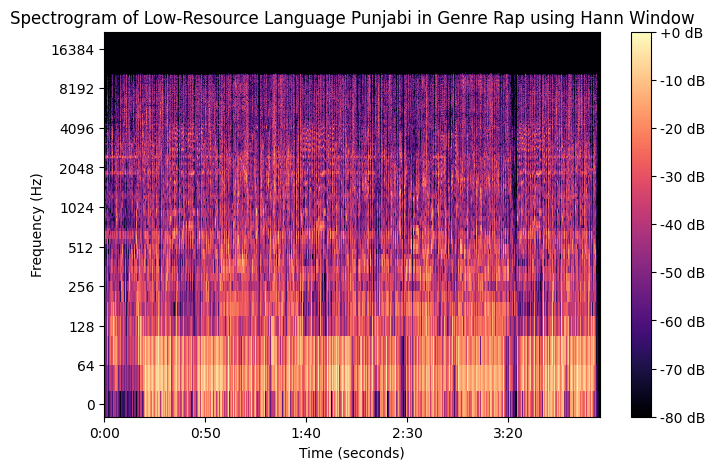

In [34]:
stft_hann_db = get_stft_hann_db(file_path4, sample_rate, win_length, hop_length)
plt.figure(figsize=(8, 5))
librosa.display.specshow(stft_hann_db, sr=sample_rate, hop_length=hop_length, x_axis='time', y_axis='log')
plt.colorbar(format='%+2.0f dB')
plt.title("Spectrogram of Low-Resource Language Punjabi in Genre Rap using Hann Window")
plt.xlabel("Time (seconds)")
plt.ylabel("Frequency (Hz)")